# Investigating Best Rental Location for College Student

###  Introduction/Business Problem

I have decided to investigate the problem of finding the best location for a college student to rent an appartment. The following investigation will be for a college student that is looking to go to Imperial College london and will investigate the following features as the criteria:
   
- Social Criteria:

    - Crime rate (safety)
    - Distance from University
    - Venues:
        - Gym
        - Nighclubs
        - Supermarkets
        - Public Transport Stops

- Economic Criteria:
    - Average price of Rental 

Based on the venues I will cluster together a set of clusters within the city and then preform a use classification on the determined locations using the features "average price of rental", "crime rate" and "Distance from University" to find the best cluster / location to live in.

###  Data Collection

The data collected will be based on the different boroughs in london which can be found on the following website: 

- https://en.wikipedia.org/wiki/List_of_London_boroughs

This data set will be manipulated so that it can be used in conjunction with the foursquare api to find the geolocations of Gyms, Nightclubs and Supermarkets to determine the centroids of the clusters which will be used as the optimum location to rent and appartment. Hence the following data will be collected:

- Borough: 
    - Name
    - Latitude
    - Longitude
- Venue:
    - Name
    - Latitude
    - Longitude

Following this the features "average price of rental", "crime rate" and "Travel time to University (Public Transport)" will be used to determine which cluster is the best. The data for the following can be found here:

- Travel time to the University: Google Maps
- Crime Rate: https://www.finder.com/uk/london-crime-statistics
- Average Price of Rental: https://www.mylondon.news/news/property/london-rent-prices-cheapest-borough-17525488

After finding the best cluster the results and methedology will be evaluated and the validity of the investigation provided. 

###  Parsing Wikipedia for Data Set

In [3]:
# Import libraries

import requests as rq
from bs4 import BeautifulSoup as bs
import pandas as pd
import unicodedata as udt

In [4]:
# Instead of parsing for the information in this case pandas can directly read off of Wikipedia

data = pd.read_html("https://en.wikipedia.org/wiki/List_of_London_boroughs", match = "Borough", encoding ="utf-8")[0]
data.head()

,Borough,Inner,Status,Local authority,Political control,Headquarters,Area (sq mi),Population (2013 est)[1],Co-ordinates,Nr. in map
0,Barking and Dagenham [note 1],NaN,NaN,Barking and Dagenham London Borough Council,Labour,"Town Hall, 1 Town Square",13.93,194352,".mw-parser-output .geo-default,.mw-parser-outp...",25
1,Barnet,NaN,NaN,Barnet London Borough Council,Conservative,"Barnet House, 2 Bristol Avenue, Colindale",33.49,369088,51°37′31″N 0°09′06″W﻿ / ﻿51.6252°N 0.1517°W,31
2,Bexley,NaN,NaN,Bexley London Borough Council,Conservative,"Civic Offices, 2 Watling Street",23.38,236687,51°27′18″N 0°09′02″E﻿ / ﻿51.4549°N 0.1505°E,23
3,Brent,NaN,NaN,Brent London Borough Council,Labour,"Brent Civic Centre, Engineers Way",16.70,317264,51°33′32″N 0°16′54″W﻿ / ﻿51.5588°N 0.2817°W,12
4,Bromley,NaN,NaN,Bromley London Borough Council,Conservative,"Civic Centre, Stockwell Close",57.97,317899,51°24′14″N 0°01′11″E﻿ / ﻿51.4039°N 0.0198°E,20


In [5]:
# Change the characters within the Headers to Allow for finding the columns
data.rename(columns = lambda col: udt.normalize("NFKD", col), inplace = True)

In [6]:
# Check the shape of the Data from Wikipedia
data.shape

(32, 10)

Since not all data is required that is available on wikipedia the following columns need to be deleted "Post Town", "Dial Code" and "Os grid ref", the "Postcode District" will allow us to find the location of the borough later.

In [7]:
# Dropping the Columns and Creating a new dataset
df = data.drop(columns = ["Inner","Status", "Local authority", "Political control", "Headquarters", "Area (sq mi)", "Population (2013 est)[1]", "Nr. in map"])
df.head()

,Borough,Co-ordinates
0,Barking and Dagenham [note 1],".mw-parser-output .geo-default,.mw-parser-outp..."
1,Barnet,51°37′31″N 0°09′06″W﻿ / ﻿51.6252°N 0.1517°W
2,Bexley,51°27′18″N 0°09′02″E﻿ / ﻿51.4549°N 0.1505°E
3,Brent,51°33′32″N 0°16′54″W﻿ / ﻿51.5588°N 0.2817°W
4,Bromley,51°24′14″N 0°01′11″E﻿ / ﻿51.4039°N 0.0198°E


In [8]:
# Removing notes and formating from the Boroughs using regular expressions
import re

df["Borough"] = df["Borough"].str.replace(" \[note+ [0-9]\]", "")

lat = [re.search("[0-9]+[.]+[0-9]+",item)[0] for item in df["Co-ordinates"].values] 
long = [re.search(" [0-9]+[.]+[0-9]+[°]+[A-Z]", item)[0].strip() for item in df["Co-ordinates"].values ]
long = [ "-" + re.search("[0-9]+[.]+[0-9]+", item)[0] if re.search("[A-Z]+", item)[0] == "W" else re.search("[0-9]+[.]+[0-9]+", item)[0] for item in long]

df["Latitude"] = lat
df["Longitude"] = long

In [9]:
df.drop(columns = ["Co-ordinates"], inplace = True)

In [10]:
# Convert to float
df[["Latitude","Longitude"]] = df[["Latitude","Longitude"]].astype("float")

In [11]:
df.head()

,Borough,Latitude,Longitude
0,Barking and Dagenham,51.5607,0.1557
1,Barnet,51.6252,-0.1517
2,Bexley,51.4549,0.1505
3,Brent,51.5588,-0.2817
4,Bromley,51.4039,0.0198


In [12]:
# Gives the size of the data
data.shape

(32, 10)

Now that the data has been cleaned up we can see that a total of 60 boroughs will be investigated to find the ideal one to live in for a hypothetical imperial colege london student. Using this information the geolocation can be found and a map with the boroughs plotted. 

#### Plotting Boroughs in England

In [13]:
# Finding address of London
import folium as fl
from geopy. geocoders import Nominatim as nm

address = 'London, UK'

gl= nm(user_agent = "coursera project")
loc = gl.geocode(address)
latitude = loc.latitude
longitude = loc.longitude
print('Coords London = Lat: {}, Long: {}.'.format(latitude, longitude))

Coords London = Lat: 51.5073219, Long: -0.1276474.


In [14]:
# Creating map of london
map_t = fl.Map(location = [latitude, longitude], zoom_start = 10)
    
for lat, lng, borough in zip(df["Latitude"], df["Longitude"], df["Borough"]):
    # Labeling Marker
    label = '{}'.format(borough)
    label = fl.Popup(label, parse_html=True)
    # Creating Marker
    fl.CircleMarker(
        [lat, lng],
        radius=1,
        popup=label,
        color='red',
        parse_html=False).add_to(map_t)  
    
    
    
map_t

#### Parsing from remaining Data

Now I will calculate the euclidean distance from imperial college london

In [15]:
address = 'Imperial College London, UK'

gl= nm(user_agent = "course project")
loc = gl.geocode(address)
latuni = loc.latitude
longuni = loc.longitude
print('Coords Imperial College London = Lat: {}, Long: {}.'.format(latuni, longuni))

Coords Imperial College London = Lat: 51.4989834, Long: -0.17462874609390266.


In [16]:
# Mapping Location of Imperial
map_t = fl.Map(location = [latitude, longitude], zoom_start = 10)
    
# Labeling Marker
label = "Imperial College London"
label = fl.Popup(label, parse_html=True)
# Creating Marker
fl.CircleMarker(
    [latuni, longuni],
    radius=1,
    popup=label,
    color='red',
    parse_html=False).add_to(map_t)  
    
map_t

In [17]:
# Finding euclidian distance
import numpy as np
from sklearn import preprocessing as pre

distance = [round(np.sqrt(np.power(lat - latuni, 2) + np.power(lng - longuni, 2)), 3) for lat,lng in zip(df["Latitude"], df["Longitude"])]

df["Distance"] = distance

# Normalizing Euclidiean Distance

df["Distance"] = pre.normalize(df[["Distance"]], norm = "max", axis = 0)
df.head()


,Borough,Latitude,Longitude,Distance
0,Barking and Dagenham,51.5607,0.1557,0.913043
1,Barnet,51.6252,-0.1517,0.347826
2,Bexley,51.4549,0.1505,0.891304
3,Brent,51.5588,-0.2817,0.334239
4,Bromley,51.4039,0.0198,0.586957


Next I will parse the Crime Data

In [18]:
# Fetching request for Data
fh = rq.get("https://www.finder.com/uk/london-crime-statistics")
Soup = bs(fh.text)

# Parsing through the Table
parse = Soup.find_all("tbody", class_ = "luna-table__body")[1].find_all("td")
loc = [item.text for item in  parse[0::3]]
crime = [item.text.replace(",","") for item in  parse[1::3]]

# Adding feature to Set
df["Crime"] = crime

# Normalizing the Crime
df["Crime"] = pre.normalize(df[["Crime"]], norm = "max", axis = 0)
df.head()

,Borough,Latitude,Longitude,Distance,Crime
0,Barking and Dagenham,51.5607,0.1557,0.913043,0.287882
1,Barnet,51.6252,-0.1517,0.347826,0.433556
2,Bexley,51.4549,0.1505,0.891304,0.248944
3,Brent,51.5588,-0.2817,0.334239,0.431029
4,Bromley,51.4039,0.0198,0.586957,0.350556


Next I will parse the Rental Price

In [19]:
# Fetching request for Data
fh = rq.get("https://www.mylondon.news/news/property/london-rent-prices-cheapest-borough-17525488")
Soup = bs(fh.text)
# Parsing through the Data
soap = Soup.find_all("p")[9:]
new = [re.findall("Average rent for a room: £[0-9]+.+", item.text) for item in soap]

newer = []

for item in new:
    try: 
        newer.append(re.findall("\d+.+[^pcm]", item[0])[0].strip())
    except:
        continue
len(newer)

newer = [item.replace(",","") for item in newer]


newer[1] = (int(newer[1]) + int(newer[2]))/2
newer[13] = (int(newer[13]) + int(newer[14]))/2
newer[21] = (int(newer[21]) + int(newer[22]))/2

newer.pop(2)
newer.pop(14)
newer.pop(22)

df["Rent"] = newer

df["Rent"] = pre.normalize(df[["Rent"]], norm = "max", axis = 0)
df.head()

archive = df[["Borough","Latitude", "Longitude","Rent", "Crime", "Distance"]]

#### Using Foursquare to find Venues

In [20]:
import runpy
fh = runpy.run_path("C:/Users/howto/Downloads/CourseraProject/credentials.py")

In [21]:
def NearbyVenues(venue, radius, names, latitudes, longitudes):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
            
        # set an api call
        
        par = {'client_id': fh["credentials"]["cid"],
        'client_secret': fh["credentials"]["cs"],
        'v': '20190425', 
        'limit': 2,
        'll':  str(lat)+","+str(lng),
        'query': venue,
        'radius': radius}

        # Parse through json and extract nessassery information
    
        file = rq.get("https://api.foursquare.com/v2/venues/search", params = par).json()["response"]["venues"]
        for v in file:
            venues_list.append([
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng'],  
            ])
        
        # Create Data Frame for the extracted information
        
        nvenues = pd.DataFrame([item for venue_list in venues_list for item in venues_list])
        nvenues.columns = ['Borough', 
                  'Borough Latitude', 
                  'Borough Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude']
    return(nvenues)

In [22]:
gym = NearbyVenues("GYM", 5000, df["Borough"], df["Latitude"], df["Longitude"])

In [23]:
gym

,Borough,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude
0,Barking and Dagenham,51.5607,0.1557,Y's Gym,51.565280,0.184793
1,Barking and Dagenham,51.5607,0.1557,The Gym London Chadwell Heath,51.567393,0.117979
2,Barnet,51.6252,-0.1517,Pumping Iron Fitness Gym,51.617391,-0.143078
3,Barnet,51.6252,-0.1517,Nuffield Health Fitness & Wellbeing Gym,51.613354,-0.147670
4,Bexley,51.4549,0.1505,Better Gym Bexleyheath,51.458329,0.132591
...,...,...,...,...,...,...
4091,Waltham Forest,51.5908,-0.0134,Better Gym Walthamstow Stadium,51.603340,-0.016259
4092,Wandsworth,51.4567,-0.1910,PureGym,51.456930,-0.192081
4093,Wandsworth,51.4567,-0.1910,Gym at Millennium Gloucester,51.493519,-0.183564
4094,Westminster,51.4973,-0.1372,The Gym,51.485305,-0.126244


In [24]:
stops = NearbyVenues("public stop", 5000, df["Borough"], df["Latitude"], df["Longitude"])

In [25]:
stops

,Borough,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude
0,Barking and Dagenham,51.5607,0.1557,Public Advice And Service Centre,51.578846,0.184846
1,Barking and Dagenham,51.5607,0.1557,Bus Stop Y (73397),51.573600,0.183942
2,Barnet,51.6252,-0.1517,Bus Stop Bawtry Road,51.624584,-0.156039
3,Barnet,51.6252,-0.1517,Bus Stop BD Raleigh Drive,51.625960,-0.159909
4,Bexley,51.4549,0.1505,Bus Stop Y,51.455847,0.150103
...,...,...,...,...,...,...
4091,Waltham Forest,51.5908,-0.0134,54 bus stop bromley road,51.590418,-0.018347
4092,Wandsworth,51.4567,-0.1910,Wandsworth Town Hall Bus Stop P,51.456792,-0.191267
4093,Wandsworth,51.4567,-0.1910,Bus Stop G,51.458257,-0.194991
4094,Westminster,51.4973,-0.1372,Bus Stop SB (54915),51.497521,-0.138022


In [26]:
supermarket = NearbyVenues("supermarket", 5000, df["Borough"], df["Latitude"], df["Longitude"])

In [27]:
supermarket

,Borough,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude
0,Barking and Dagenham,51.5607,0.1557,Handrailing Supermarket,51.516325,0.187374
1,Barking and Dagenham,51.5607,0.1557,Brentwood Road Supermarket,51.570667,0.191243
2,Barnet,51.6252,-0.1517,Diamond Supermarket,51.624504,-0.123589
3,Barnet,51.6252,-0.1517,Alexandra Supermarket,51.598300,-0.138969
4,Bexley,51.4549,0.1505,Asda,51.458230,0.130125
...,...,...,...,...,...,...
4091,Waltham Forest,51.5908,-0.0134,Forest Road Supermarket,51.591509,-0.006304
4092,Wandsworth,51.4567,-0.1910,Cornucopia Supermarket,51.456459,-0.203315
4093,Wandsworth,51.4567,-0.1910,Al Salama Supermarket,51.493184,-0.213035
4094,Westminster,51.4973,-0.1372,New Loon Moon Supermarket | 新龍門行,51.512028,-0.130535


In [28]:
club = NearbyVenues("night club", 5000, df["Borough"], df["Latitude"], df["Longitude"])

In [29]:
club

,Borough,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude
0,Barking and Dagenham,51.5607,0.1557,Dagenham Rugby Club,51.557500,0.162142
1,Barking and Dagenham,51.5607,0.1557,Rush Green Social Club,51.565426,0.169344
2,Barnet,51.6252,-0.1517,North Middlesex Golf Club,51.622680,-0.167131
3,Barnet,51.6252,-0.1517,The Manor Health & Leisure Club,51.591100,-0.152552
4,Bexley,51.4549,0.1505,Pure Night Club,51.457125,0.138174
...,...,...,...,...,...,...
4091,Waltham Forest,51.5908,-0.0134,Sin night club,51.589504,-0.028743
4092,Wandsworth,51.4567,-0.1910,Embargo Night Club,51.480234,-0.185599
4093,Wandsworth,51.4567,-0.1910,Skect Night Club,51.426377,-0.164315
4094,Westminster,51.4973,-0.1372,Aura Night Club,51.507689,-0.140484


In [30]:
all_df = [gym, stops, supermarket, club]

for df in all_df:
    df.columns = ["Borough", "Borough Latitude", "Borough Longitude", "Venue","Venue Latitude", "Venue Longitude"]

newdataf = pd.concat(all_df).reset_index(drop=True)

In [31]:
newdataf.head()

,Borough,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude
0,Barking and Dagenham,51.5607,0.1557,Y's Gym,51.565280,0.184793
1,Barking and Dagenham,51.5607,0.1557,The Gym London Chadwell Heath,51.567393,0.117979
2,Barnet,51.6252,-0.1517,Pumping Iron Fitness Gym,51.617391,-0.143078
3,Barnet,51.6252,-0.1517,Nuffield Health Fitness & Wellbeing Gym,51.613354,-0.147670
4,Bexley,51.4549,0.1505,Better Gym Bexleyheath,51.458329,0.132591


#### Exploratory Data Analysis with Distance from the University  

In this section I will be investigating how the distance from the university affects crime and average rental

In [32]:
import seaborn as sns

First I will investigate how crime varies with distance

[Text(0, 0.5, 'Crime Normalized'),
 Text(0.5, 0, 'Distance Normalized'),
 Text(0.5, 1.0, 'Graph to show Relationship between Normalized Crime and Normalized Distance from ICL')]

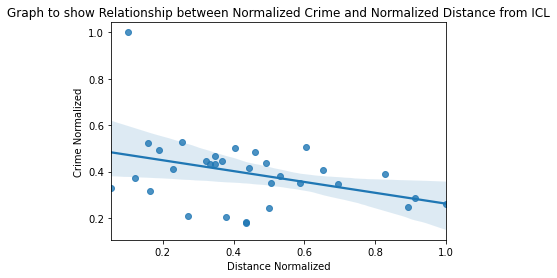

In [33]:
ax = sns.regplot(archive["Distance"], archive["Crime"], "x")
ax.set(xlabel="Distance Normalized", ylabel = "Crime Normalized", title = "Graph to show Relationship between Normalized Crime and Normalized Distance from ICL") 

From the graph it can be seen that as the distance increases crime decreases. Although there are some outliers the correlation is relatively strong as a distinct relationship can be observed. This suggests that in order to achieve lower crime the cluster would have to be in further proximity from the university. Although the distance from the university is the most important factor to minimize in this investigation, crime decreases with distance hence the optimum trade off point needs to be found. This require to find a model which finds a cluster that is both in close proximity and low crime.

Finally I will investigate how distance affects the rent

[Text(0, 0.5, 'Mean Rent Normalized'),
 Text(0.5, 0, 'Distance Normalized'),
 Text(0.5, 1.0, 'Graph to show Relationship between Normalized Distance from ICL and Mean Normalized Rent')]

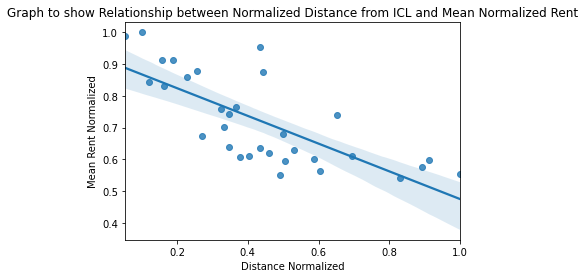

In [34]:
ax = sns.regplot(archive["Distance"], archive["Rent"], "x")
ax.set(xlabel="Distance Normalized", ylabel = "Mean Rent Normalized", title = "Graph to show Relationship between Normalized Distance from ICL and Mean Normalized Rent") 

It is possible to tell from the graph that ass the distance increases the rent significantly decreases. This relationship is much stronger in correlation and has a much steeper gradient. The trade of between distance from the university and the rent is a lot more significant than between distance and crime, however distance from the university still remains an important factor hence having to be still considered. Therefore again a trade off point needs to be found between distance and rent which will be investigated based on the location of the clusters.

In conclusion the clusters that are found using the model still need to be further evaluated to find the optimum distance to crime and rent ratio.

#### Finding the Cluster

Using the sk.learn library I use kmeans clustering to create 5 clusters intialy based on these locations. Then I will use the elbow method to find the best k number.

In [35]:
clst = newdataf[['Venue Latitude', 'Venue Longitude']]

In [36]:
from sklearn.cluster import KMeans as km
error = []
K = range(1,10)
for k in K:
    Model = km(n_clusters=k, random_state = 0).fit(clst)
    error.append(Model.inertia_)

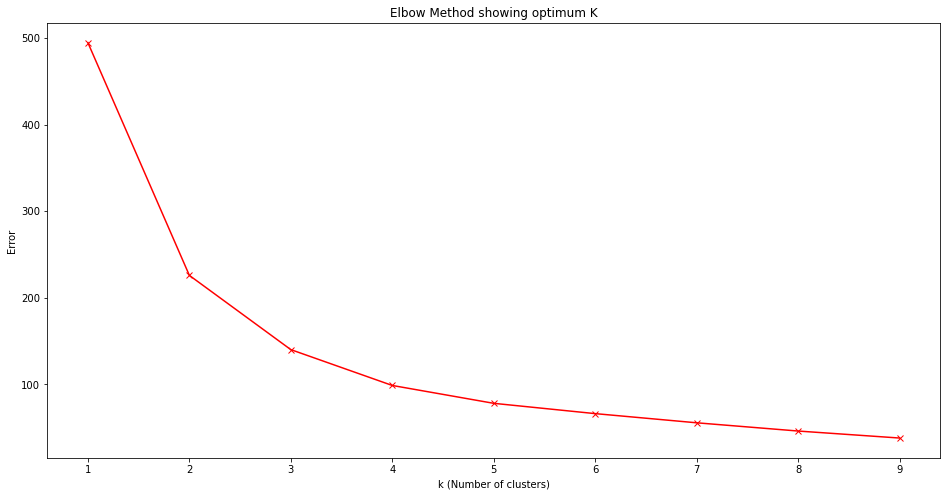

In [37]:
from matplotlib import pyplot as plt

plt.figure(figsize=(16,8))
plt.plot(K, error, "rx-")
plt.xlabel('k (Number of clusters)')
plt.ylabel('Error')
plt.title('Elbow Method showing optimum K')
plt.show()

From the Graph it is possible to tell that the elbow point is at 5 meaning 5 should be used at the number of clusters.

In [38]:
kmeans = km(n_clusters=5, random_state = 0).fit(clst)

I append the returned array with the cluster to which they belong to

In [39]:
cluster = pd.DataFrame(kmeans.labels_, columns = ["cluster"])
fincluster = pd.concat([newdataf,cluster], axis = 1)
fincluster

,Borough,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude,cluster
0,Barking and Dagenham,51.5607,0.1557,Y's Gym,51.565280,0.184793,3
1,Barking and Dagenham,51.5607,0.1557,The Gym London Chadwell Heath,51.567393,0.117979,3
2,Barnet,51.6252,-0.1517,Pumping Iron Fitness Gym,51.617391,-0.143078,4
3,Barnet,51.6252,-0.1517,Nuffield Health Fitness & Wellbeing Gym,51.613354,-0.147670,4
4,Bexley,51.4549,0.1505,Better Gym Bexleyheath,51.458329,0.132591,3
...,...,...,...,...,...,...,...
16379,Waltham Forest,51.5908,-0.0134,Sin night club,51.589504,-0.028743,4
16380,Wandsworth,51.4567,-0.1910,Embargo Night Club,51.480234,-0.185599,0
16381,Wandsworth,51.4567,-0.1910,Skect Night Club,51.426377,-0.164315,0
16382,Westminster,51.4973,-0.1372,Aura Night Club,51.507689,-0.140484,0


In [40]:
# add colors
import matplotlib.cm as cm
import matplotlib.colors as colors


# create map
clustermp = fl.Map(location=[latitude , longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(5)
ys = [i + x + (i*x)**2 for i in range(5)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(fincluster['Venue Latitude'], fincluster['Venue Longitude'], fincluster['Venue'], fincluster['cluster']):
    label = fl.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    fl.CircleMarker(
        [lat, lon],
        radius=2,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(clustermp)
       
clustermp

#### Exploring Distance, Crime and Rent within Cluster

In [42]:
newestdf = archive.join(fincluster.set_index('Borough'), on = "Borough")

In [43]:
newestdf

,Borough,Latitude,Longitude,Rent,Crime,Distance,Borough Latitude,Borough Longitude,Venue,Venue Latitude,Venue Longitude,cluster
0,Barking and Dagenham,51.5607,0.1557,0.597858,0.287882,0.913043,51.5607,0.1557,Y's Gym,51.565280,0.184793,3
0,Barking and Dagenham,51.5607,0.1557,0.597858,0.287882,0.913043,51.5607,0.1557,The Gym London Chadwell Heath,51.567393,0.117979,3
0,Barking and Dagenham,51.5607,0.1557,0.597858,0.287882,0.913043,51.5607,0.1557,Y's Gym,51.565280,0.184793,3
0,Barking and Dagenham,51.5607,0.1557,0.597858,0.287882,0.913043,51.5607,0.1557,The Gym London Chadwell Heath,51.567393,0.117979,3
0,Barking and Dagenham,51.5607,0.1557,0.597858,0.287882,0.913043,51.5607,0.1557,Y's Gym,51.565280,0.184793,3
...,...,...,...,...,...,...,...,...,...,...,...,...
31,Westminster,51.4973,-0.1372,1.000000,1.000000,0.100543,51.4973,-0.1372,White Night Club,51.509508,-0.134876,0
31,Westminster,51.4973,-0.1372,1.000000,1.000000,0.100543,51.4973,-0.1372,Aura Night Club,51.507689,-0.140484,0
31,Westminster,51.4973,-0.1372,1.000000,1.000000,0.100543,51.4973,-0.1372,White Night Club,51.509508,-0.134876,0
31,Westminster,51.4973,-0.1372,1.000000,1.000000,0.100543,51.4973,-0.1372,Aura Night Club,51.507689,-0.140484,0


In [44]:
semi = newestdf.groupby("cluster").mean()[["Rent","Crime", "Distance"]]

In [58]:
semi

,Rent,Crime,Distance
cluster,,,
0,0.810635,0.430681,0.211838
1,0.733155,0.448975,0.443071
2,0.700841,0.319511,0.492737
3,0.608025,0.325869,0.813448
4,0.702104,0.434828,0.361469


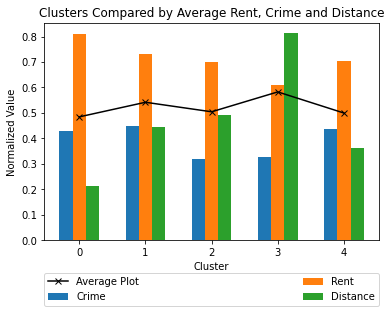

In [60]:
ind = np.arange(0,5)
width = 0.2  

plt.bar(ind-width, semi["Crime"], width, label = "Crime")
plt.bar(ind, semi["Rent"], width, label = "Rent")
plt.bar(ind+width, semi["Distance"], width, label = "Distance")
plt.plot(ind, semi.mean(axis = 1), "-xk", label = "Average Plot")
    
plt.title("Clusters Compared by Average Rent, Crime and Distance")
plt.xlabel("Cluster")
plt.ylabel("Normalized Value")
plt.legend(bbox_to_anchor=(0, -0.15, 1, 0), loc=2, ncol=2, mode="expand", borderaxespad=0)

From the graph it can be seen that it depends on which factor is most important to you if distance is important but money isnt an issue the cluster 0 is the best. On the other hand if crime is most important cluster 2 would be the best. And for the lowest rent cluster 3 would be the best. To find the overall best cluster the results will be averaged this can be seen based on the average plot the 0th cluster is the best interms of all criteria however the rent there is the heighest. To improve this investigation and ammend it for different needs the factors would need to be considered with different weightings.

In [54]:
archive.head()

,Borough,Latitude,Longitude,Rent,Crime,Distance
0,Barking and Dagenham,51.5607,0.1557,0.597858,0.287882,0.913043
1,Barnet,51.6252,-0.1517,0.638754,0.433556,0.347826
2,Bexley,51.4549,0.1505,0.574489,0.248944,0.891304
3,Brent,51.5588,-0.2817,0.702045,0.431029,0.334239
4,Bromley,51.4039,0.0198,0.601753,0.350556,0.586957


Plotting optimum cluster

In [61]:
# create map
clustermp = fl.Map(location=[latitude , longitude], zoom_start=11)

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(fincluster['Venue Latitude'], fincluster['Venue Longitude'], fincluster['Venue'], fincluster['cluster']):
    if cluster == 0:
        label = fl.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
        fl.CircleMarker(
            [lat, lon],
            radius=2,
            popup=label,
            color="red",
            fill=True,
            fill_color=rainbow[cluster-1],
            fill_opacity=0.7).add_to(clustermp)
       
clustermp

The best cluster according to the investigation would be south london